# PEC1. Deep learning autoencoder for reconstructing brain magnetic resonance images

David Patiño


In [1]:
import collections
from glob import glob
import matplotlib.pylab as plt
import nibabel as nib
import numpy as np
import os
import pandas
from scipy import stats
from skimage.util import montage

## Reading NIFTI images

Get dataset image list. Read shape and minimum, maximum and mean voxel values for each image

In [2]:
files = glob('dataset/IXI-T1/*.gz')

for file in files:
    img = nib.load(file)
    print(img.header)
    break

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 0
dim             : [  3 256 256 150   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int16
bitpix          : 16
slice_start     : 0
pixdim          : [-1.        0.9375    0.9375    1.199997  0.        0.        0.
  0.      ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 10
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 0
glmin           : 0
descrip         : b'MR'
aux_file        : b''
qform_code      : scanner
sform_code      : scanner
quatern_b       : 0.468175
quatern_c       : -0.5299171
quatern_d       : -0.468175
qoffset_x       : -88.63989
qoffset_y       : 116.

In [3]:
shapes = []
orientations = []
pixdims = []
ranges = dict()
for file in files:
    img = nib.load(file)
    volumeData = img.get_fdata()
    source = os.path.basename(file).split('-')[1]
    if not source in ranges.keys():
        ranges[source] = []

    shapes.append(volumeData.shape)
    orientations.append(nib.aff2axcodes(img.affine))
    pixdims.append(img.header['pixdim'][1:4])
    ranges[source].append([np.min(volumeData), np.max(volumeData), np.mean(volumeData)])


In [4]:
collections.Counter(orientations)

Counter({('P', 'S', 'R'): 581})

All volumes share the same orientation

In [5]:
stats.describe(np.array(pixdims)[:, 0] - np.array(pixdims)[:, 1])

DescribeResult(nobs=581, minmax=(-2.360344e-05, 1.5437603e-05), mean=-3.6398842e-07, variance=9.936384620393625e-12, skewness=-1.8117415430971684, kurtosis=16.09990364420148)

All volumes are isotropic on the first and second dimensions. This is hinted by the pixdim field of the sampled header and confirmed by the small range around 0 for the difference between first and second dimensions voxel size.

## Voxel value stats

In [6]:
stats.describe(np.concatenate(list(ranges.values()), 0)[:, 0])

DescribeResult(nobs=581, minmax=(0.0, 0.0), mean=0.0, variance=0.0, skewness=nan, kurtosis=nan)

In [7]:
stats.describe(np.concatenate(list(ranges.values()), 0)[:, 1])

DescribeResult(nobs=581, minmax=(114.0, 16790.0), mean=3034.960851403399, variance=13075307.390331056, skewness=2.075249865022079, kurtosis=2.856323201563601)

In [8]:
stats.describe(np.concatenate(list(ranges.values()), 0)[:, 2])

DescribeResult(nobs=581, minmax=(12.469410502115885, 1279.3461077964469), mean=264.36096250947645, variance=70081.92558591766, skewness=1.9050621758015316, kurtosis=2.4847482408055876)

Voxels are filled with a value from 0 to an undeterminate limit, there's a big variance between the maximum values

In [9]:
for key in ranges:
    print(key)
    print(stats.describe(np.array(ranges[key])[:, 1]))
    print(stats.describe(np.array(ranges[key])[:, 2]))
    print()

Guys
DescribeResult(nobs=322, minmax=(114.0, 3573.952440261841), mean=1545.4736836489683, variance=818059.12077644, skewness=1.0774269659369593, kurtosis=-0.6969159869855162)
DescribeResult(nobs=322, minmax=(12.469410502115885, 462.75754042512347), mean=180.3612731426564, variance=12036.120759999705, skewness=1.1280969989080532, kurtosis=-0.4555470201273062)

HH
DescribeResult(nobs=185, minmax=(980.0, 5587.68788766861), mean=1995.4579920562537, variance=936090.954807311, skewness=2.5545573384904707, kurtosis=5.03307227474331)
DescribeResult(nobs=185, minmax=(103.93887095133464, 422.555013444435), mean=155.22339350735433, variance=5470.0841648823225, skewness=2.6328849275163835, kurtosis=5.283899772343464)

IOP
DescribeResult(nobs=74, minmax=(9140.0, 16790.0), mean=12115.0, variance=1828348.301369863, skewness=0.7135715412911459, kurtosis=1.6220660358425354)
DescribeResult(nobs=74, minmax=(670.8913424766228, 1279.3461077964469), mean=902.7170468541879, variance=15712.143060530176, skewn

## Shape stats

In [10]:
collections.Counter(shapes)

Counter({(256, 256, 150): 503,
         (256, 256, 140): 2,
         (256, 256, 130): 2,
         (256, 256, 146): 74})

The general shape seems to be 256x256x150, but there are a few images with a bit less than 150 pixels in the third dimension. This means fewer slices were taken on those cases.

## Visualizing images

In [11]:
##
# Prints a volume as a composition of slices.
#
# @param index image number from the 'files' list
def printVolume(index):
    fig, ax1 = plt.subplots(1, 1, figsize = (50, 50))
    volumeData = nib.load(files[index]).get_fdata()
    ax1.imshow(montage(volumeData), cmap ='bone')
    plt.show()

##
# Prints a sample slice on each axis.
# As a sample, one of the central slices is taken.
#
# @param index image number from the 'files' list
def printSlices(index):
    fig, ax1 = plt.subplots(1, 3)
    volumeData = nib.load(files[index]).get_fdata()
    slice_0 = volumeData[128, :, :]
    slice_1 = volumeData[:, 128, :]
    slice_2 = volumeData[:, :, 75]
    ax1[0].imshow(slice_0, cmap ='bone')
    ax1[1].imshow(slice_1, cmap ='bone')
    ax1[2].imshow(slice_2, cmap ='bone')
    plt.show()

### Sample slices from NIFTI images

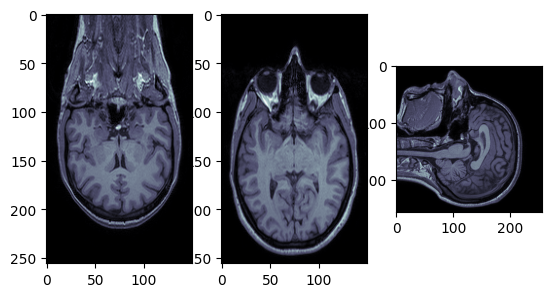

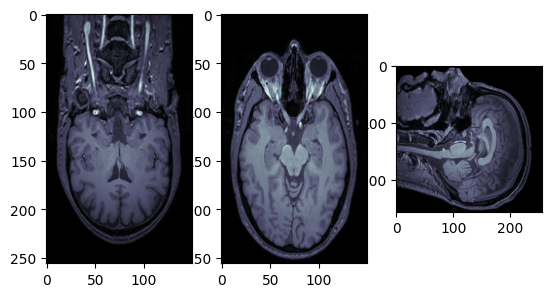

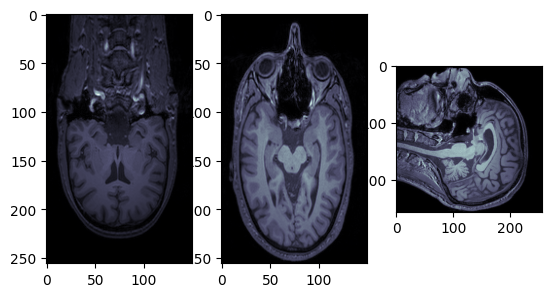

In [12]:
printSlices(0)
printSlices(35)
printSlices(78)

From these views, we can see the scans were taken as slices on the sagittal plane, where we have the full 256x256 resolution

### Sample NIFTI volumes

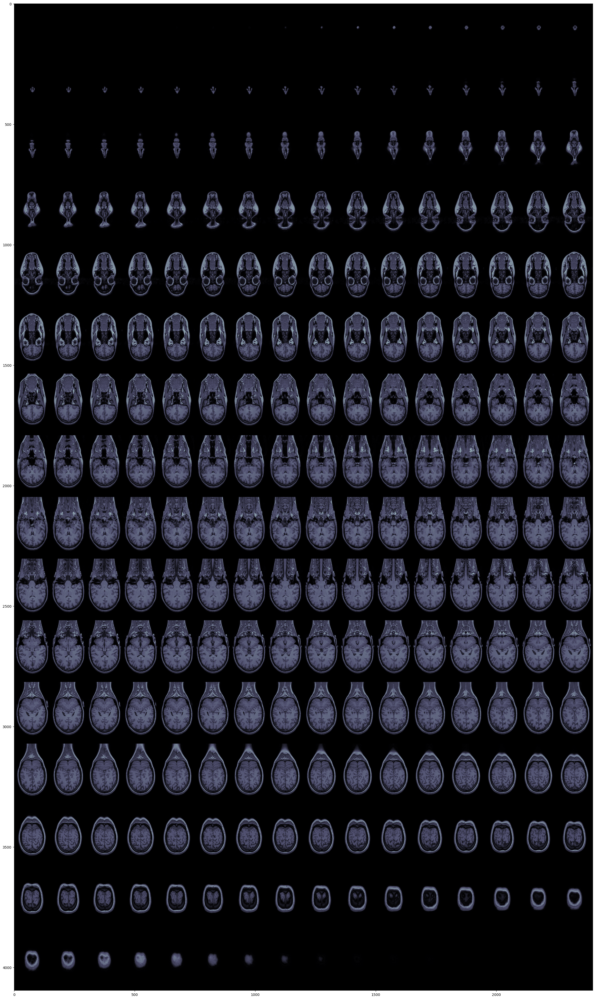

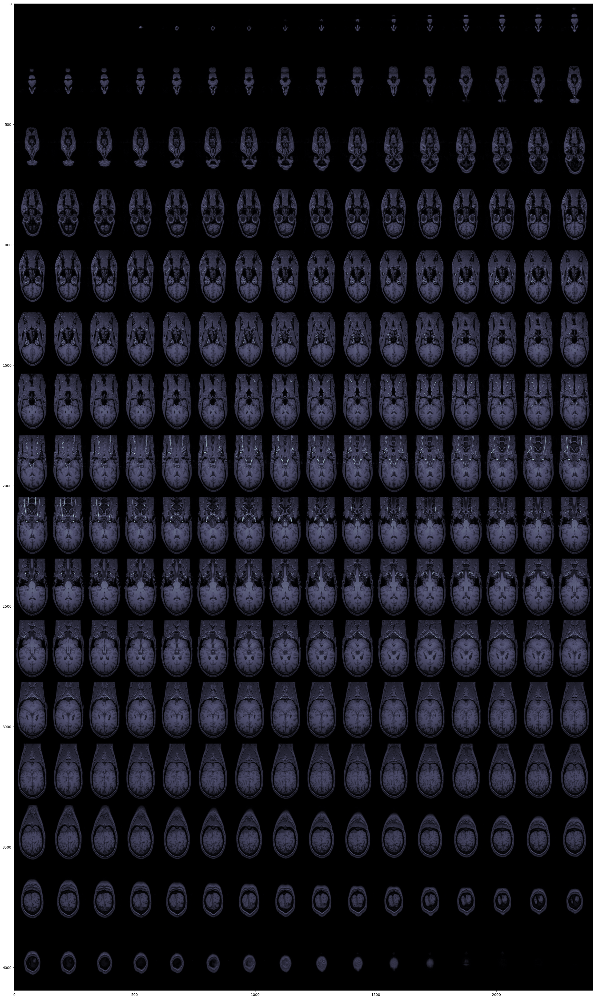

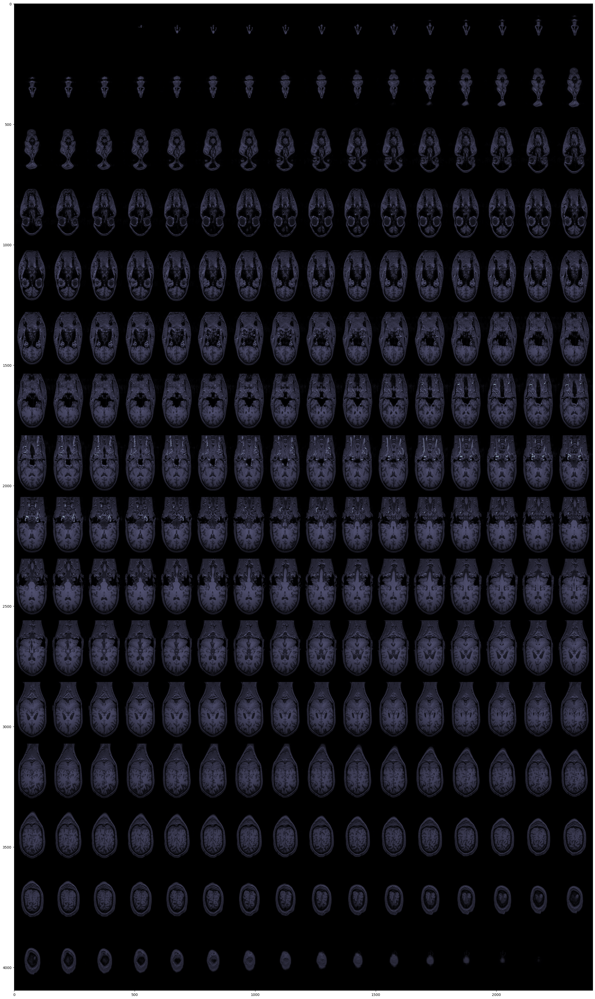

In [13]:
printVolume(0)
printVolume(35)
printVolume(78)